# Tarea 5: Análisis de imágenes
* Materia: Procesamiento de datos
* Alumno: Fernando Barajas
* Matrícula: 2085375

En este trabajo se realiza una revisión de algunas de las librerías más utilizadas para el análisis de imágenes. Las librerías empleadas para este código son:
1. Python Image Library (Pillow/PIL)
2. ITK
3. Scikit-Image
4. Open-CV

## 1. Pillow

In [88]:
# Importar librerias de PILLOW
from PIL import Image
import matplotlib as plt

# Imagen de fondo
filename = "M:\TRABAJO CLASE\MATERIAS\(T4) Procesamiento de Datos\Tarea 4\space2.jpg"
with Image.open(filename) as bg:
    bg.load()

type(bg)
isinstance(bg, Image.Image)

True

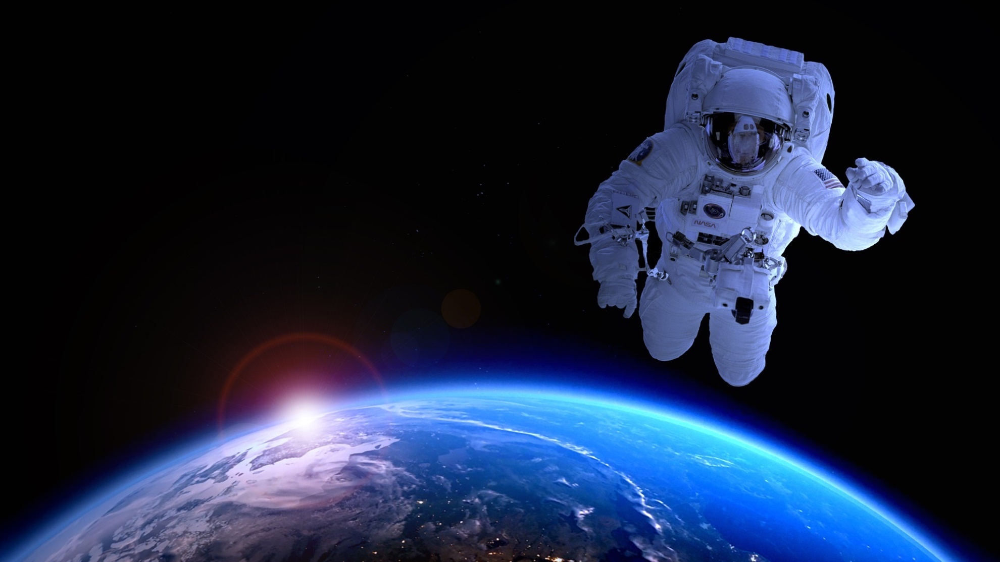

In [89]:
# Esta es la imagen de fondo con la que se va a trabajar
bg

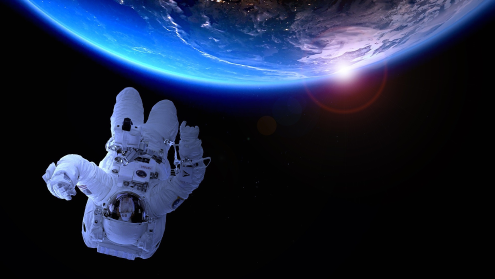

In [90]:
# Aplicar filtros a la imagen
from PIL import Image, ImageFilter

# Filtro de "SHARPEN", para hacer disminuir el suavizado entre las transiciones de las diferentes áreas de la imagen. 
bg.sharp = bg.filter(ImageFilter.SHARPEN)
bg.rotate = bg.sharp.rotate(180)

# Reducir tamaño de imagen a la mitad
bg.reduce = bg.rotate.reduce(4)
bg.reduce

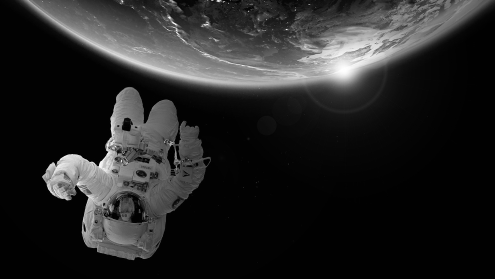

In [91]:
# Escala de grises
bg.gray = bg.reduce.convert("L")
bg.gray

In [93]:
print(bg.reduce.getbands())
# print(cmyk_img.getbands())
print(bg.gray.getbands())

('R', 'G', 'B')
('L',)


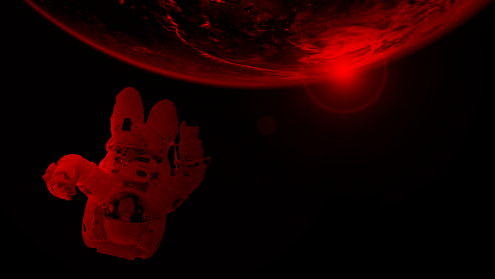

In [169]:
# Separación de canales de colores
red, green, blue = bg.reduce.split()

zeroed_band = red.point(lambda _: 0)

red_merge = Image.merge("RGB", (red, zeroed_band, zeroed_band))
green_merge = Image.merge("RGB", (zeroed_band, green, zeroed_band))
blue_merge = Image.merge( "RGB", (zeroed_band, zeroed_band, blue))

# Ejemplo de la imagen con un filtro rojo:
red_merge

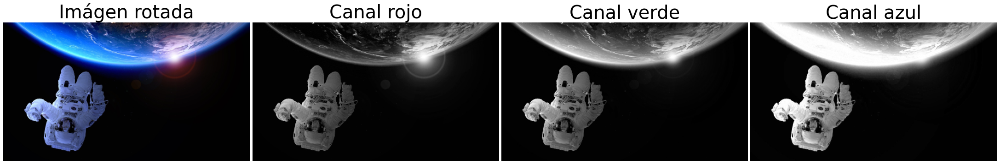

In [170]:
# Comparativa de la imágen original y la información que se muestra en cada uno de los canales
fig = plt.figure(figsize=(30,30))
ax1 = fig.add_subplot(1,4,1)
ax1.imshow(bg.reduce); plt.axis('off'); plt.title("Imágen rotada", fontdict={'fontsize': 40})
ax2 = fig.add_subplot(1,4,2)
ax2.imshow(red, cmap='gray'); plt.axis('off'); plt.title("Canal rojo", fontdict={'fontsize': 40})
ax3 = fig.add_subplot(1,4,3)
ax3.imshow(green, cmap='gray'); plt.axis('off'); plt.title("Canal verde", fontdict={'fontsize': 40})
ax4 = fig.add_subplot(1,4,4)
ax4.imshow(blue, cmap='gray'); plt.axis('off'); plt.title("Canal azul", fontdict={'fontsize': 40})

plt.gca().set_axis_off()
plt.subplots_adjust(top = 1, bottom = 0, right = 1, left = 0, 
            hspace = 0, wspace = 0.01)

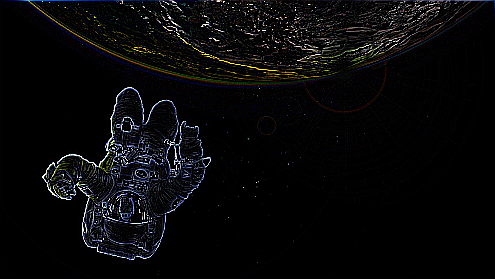

In [171]:
# Aplicación de filtro de detección de orillas
edges = bg.reduce.filter(ImageFilter.FIND_EDGES)
edges

In [ ]:
# img.rotate(45, expand=True)

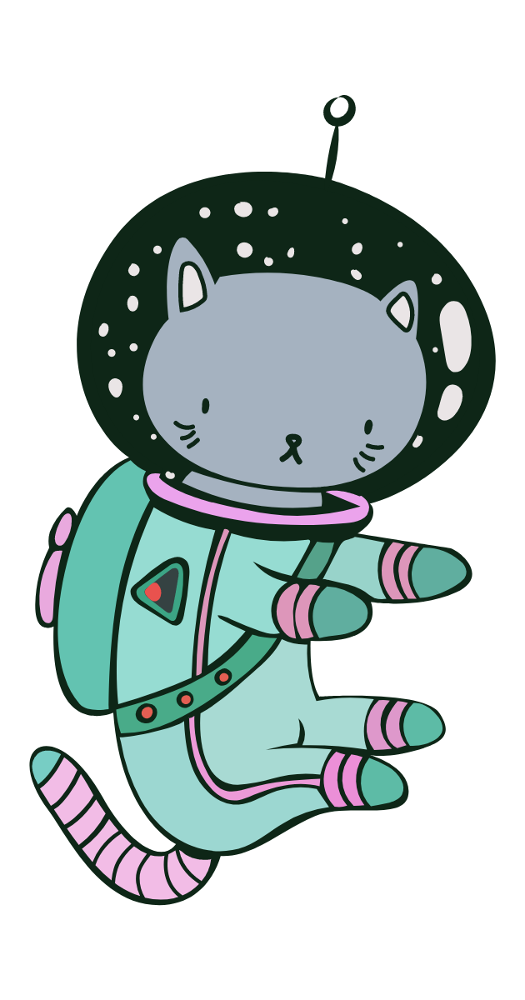

In [65]:
# Imagen que se superpone al fondo
filename = "M:\TRABAJO CLASE\MATERIAS\(T4) Procesamiento de Datos\Tarea 4\cat.png"
with Image.open(filename) as cat:
    cat.load()
cat

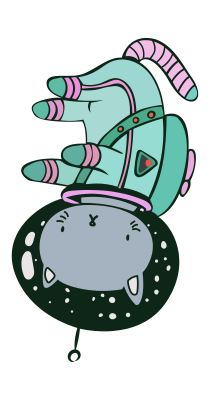

In [66]:
# Reducir de tamaño la imagen a la mitad
reduce_cat = cat.reduce(3)

# Rotar imagen boca abajo
rotate_cat = reduce_cat.rotate(180)
rotate_cat

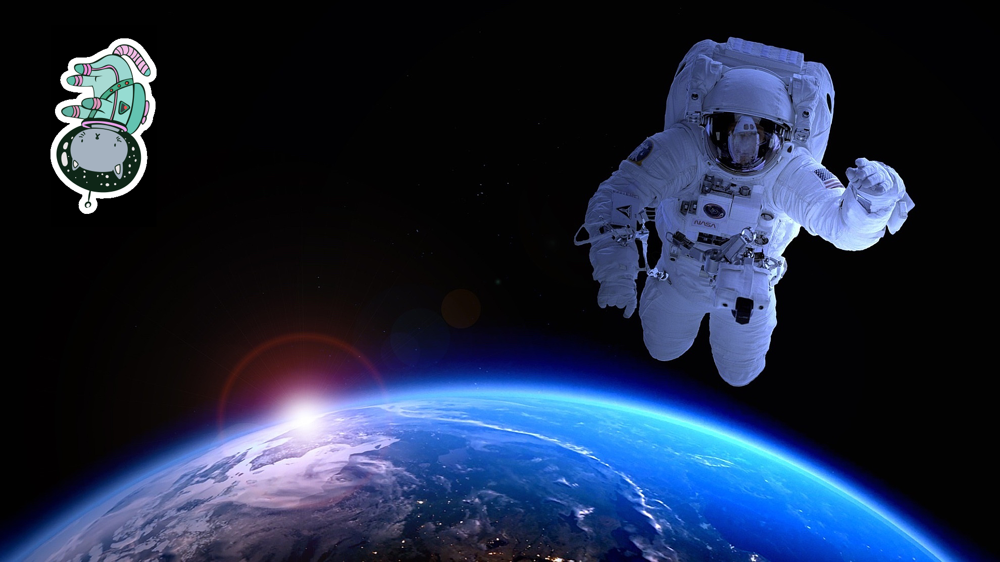

In [67]:
# Generar la máscara de la imagen
back_im = filtered.copy()
back_im.paste(rotate_cat, (100, 50))
back_im
# back_im.save('data/dst/rocket_pillow_paste_pos.jpg', quality=95)

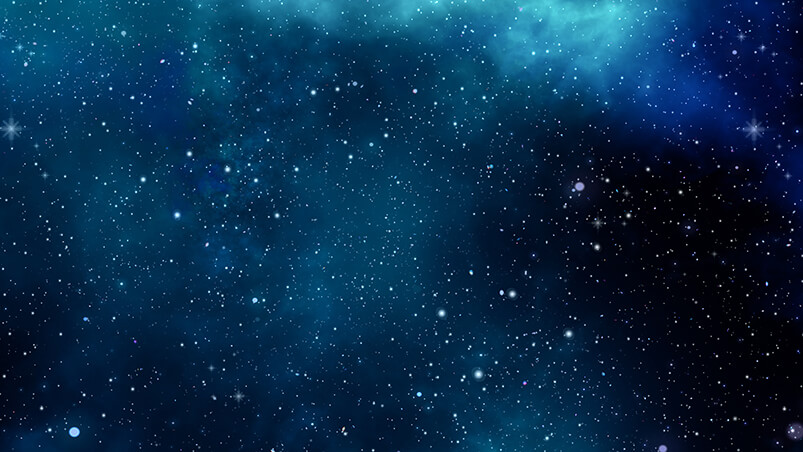

In [31]:
# Superposición de imagenes

background.paste(
    rotate_cat.resize((rotate_cat.width // 5, rotate_cat.height // 5)),
    (1300, 750),
    cat_mask.resize((cat_mask.width // 5, cat_mask.height // 5)),
)

background

In [ ]:
# rotate_cat = cat.rotate(45)
# rotate_cat


In [ ]:
# rotate_cat = cat.rotate(45)
# rotate_cat


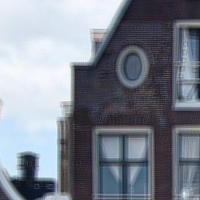

In [ ]:
blur_img.crop((300, 300, 500, 500))

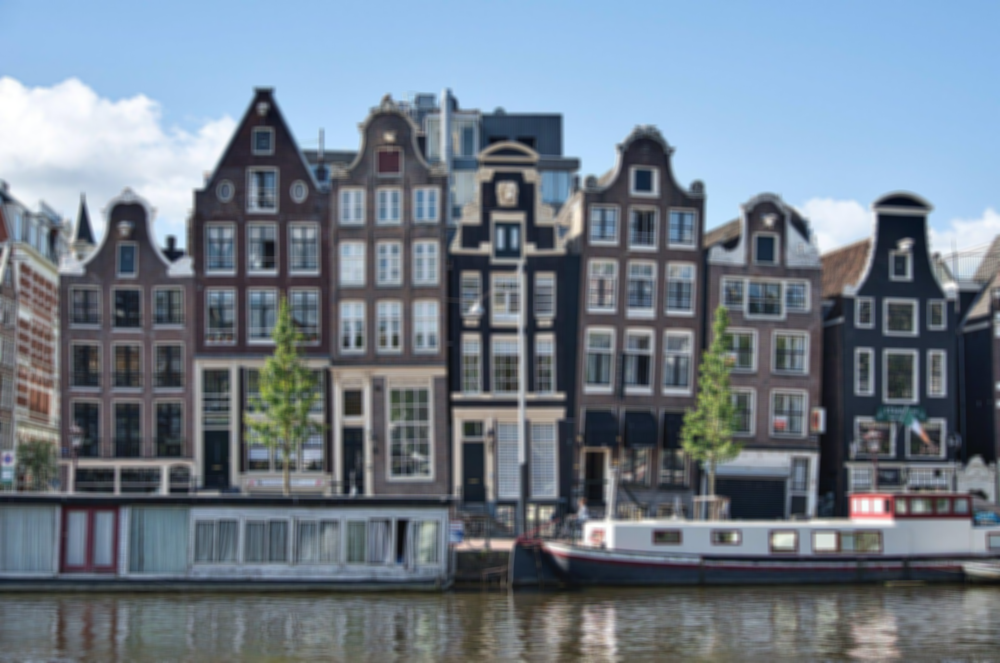

In [ ]:
img.filter(ImageFilter.BoxBlur(5))

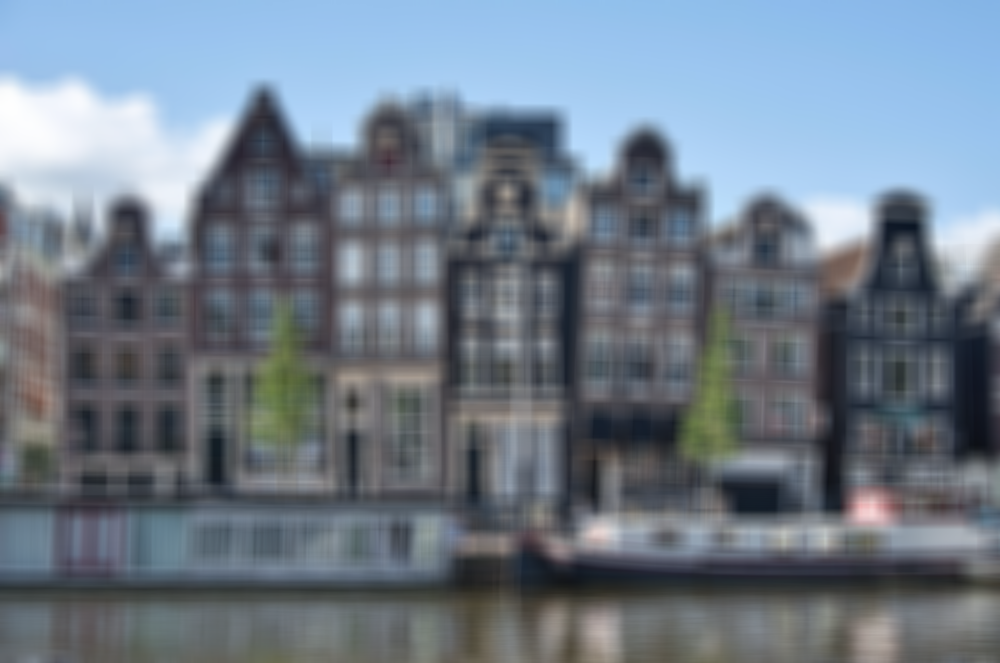

In [ ]:
img.filter(ImageFilter.BoxBlur(20))

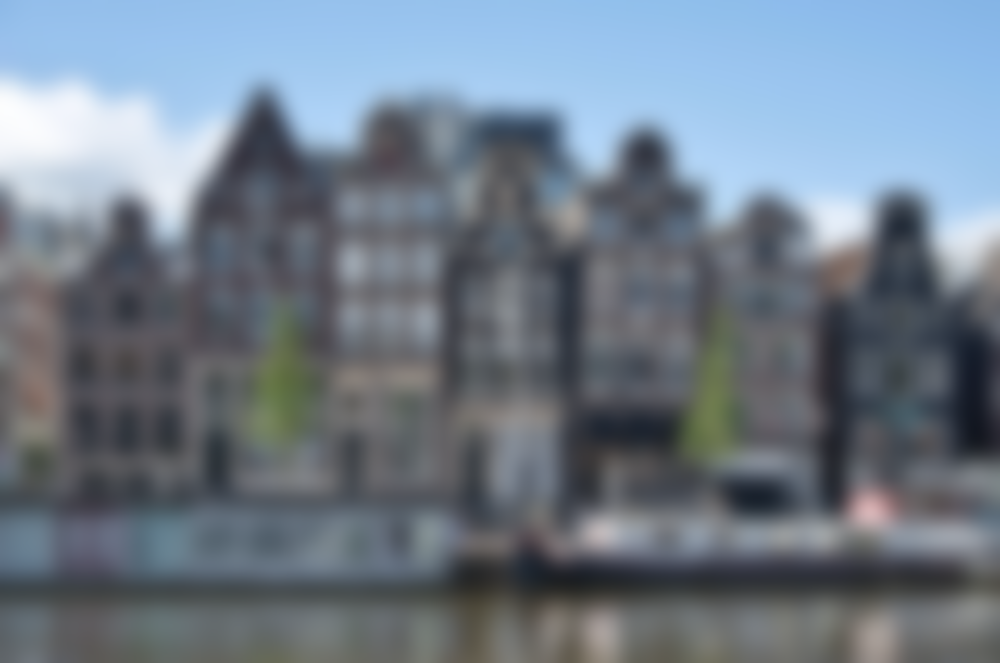

In [ ]:
img.filter(ImageFilter.GaussianBlur(20))

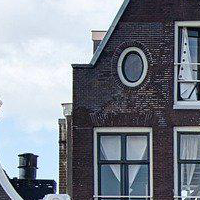

In [ ]:
sharp_img = img.filter(ImageFilter.SHARPEN)
img.crop((300, 300, 500, 500))


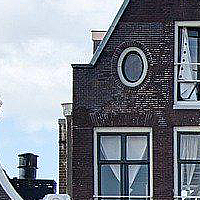

In [ ]:
sharp_img.crop((300, 300, 500, 500))

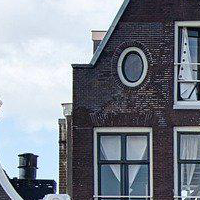

In [ ]:
smooth_img = img.filter(ImageFilter.SMOOTH)
img.crop((300, 300, 500, 500))

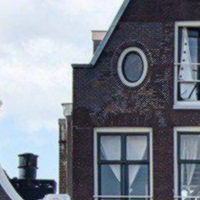

In [ ]:

smooth_img.crop((300, 300, 500, 500))

### Deteccion de bordes, mejora de bordes y embossing.

Cuando miramos una imagen para nosotros es bastante sencillo determinar los bordes de los objetos. Para un algoritmo se necesita un kernel especial.


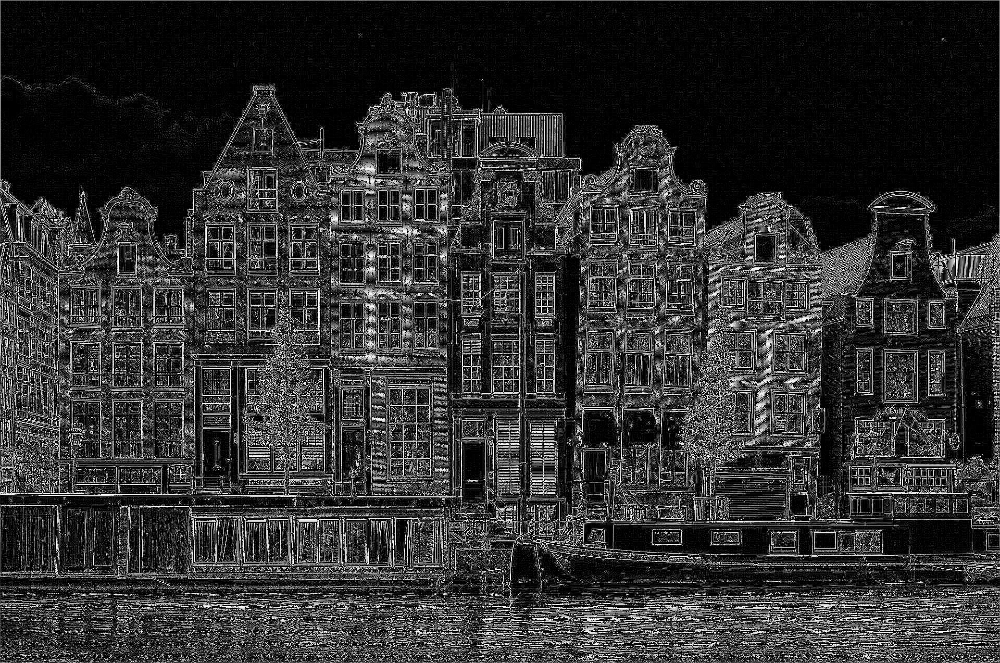

In [ ]:
img_gray = img.convert("L")
edges = img_gray.filter(ImageFilter.FIND_EDGES)
edges

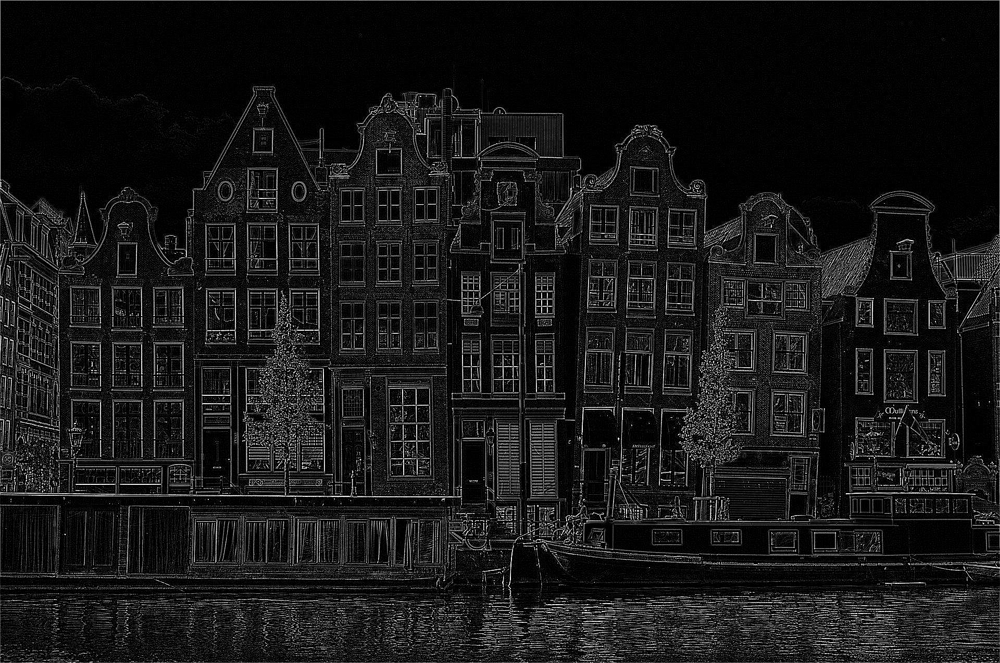

In [ ]:
img_gray_smooth = img_gray.filter(ImageFilter.SMOOTH)
edges_smooth = img_gray_smooth.filter(ImageFilter.FIND_EDGES)
edges_smooth

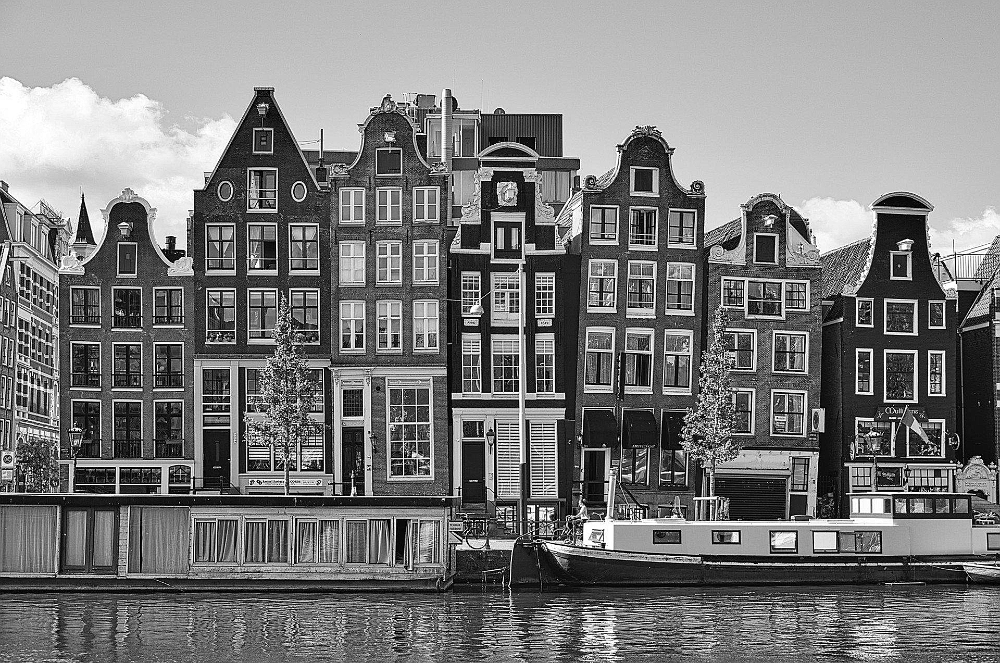

In [ ]:
edge_enhance = img_gray_smooth.filter(ImageFilter.EDGE_ENHANCE)
edge_enhance

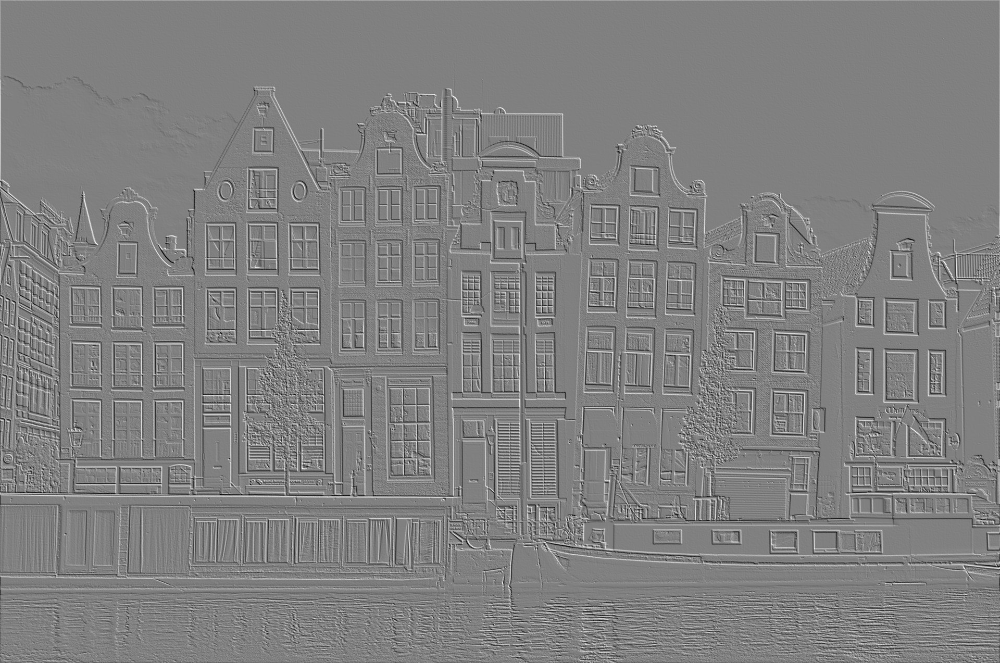

In [ ]:
emboss = img_gray_smooth.filter(ImageFilter.EMBOSS)
emboss

## Segmentacion de imagenes y superposicion.

Pillow tiene una libreria para usar este tipo de procesamiento.

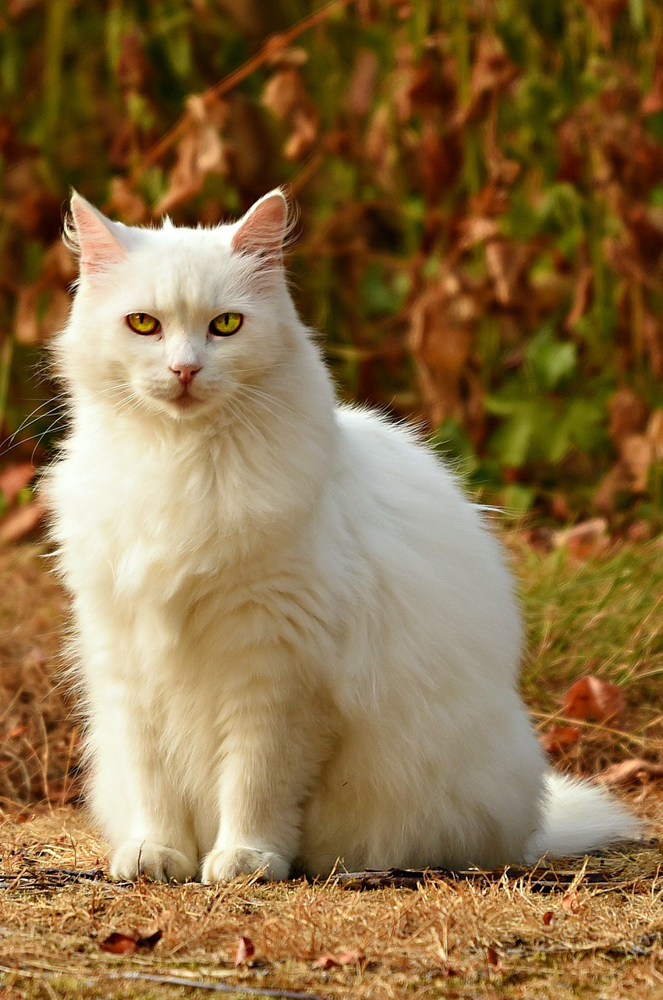

In [ ]:
from PIL import Image
filename_cat = "/content/drive/MyDrive/Datasets/kitty.jpg"

with Image.open(filename_cat) as img_cat:
    img_cat.load()
img_cat = img_cat.crop((800, 0, 1650, 1281))
img_cat

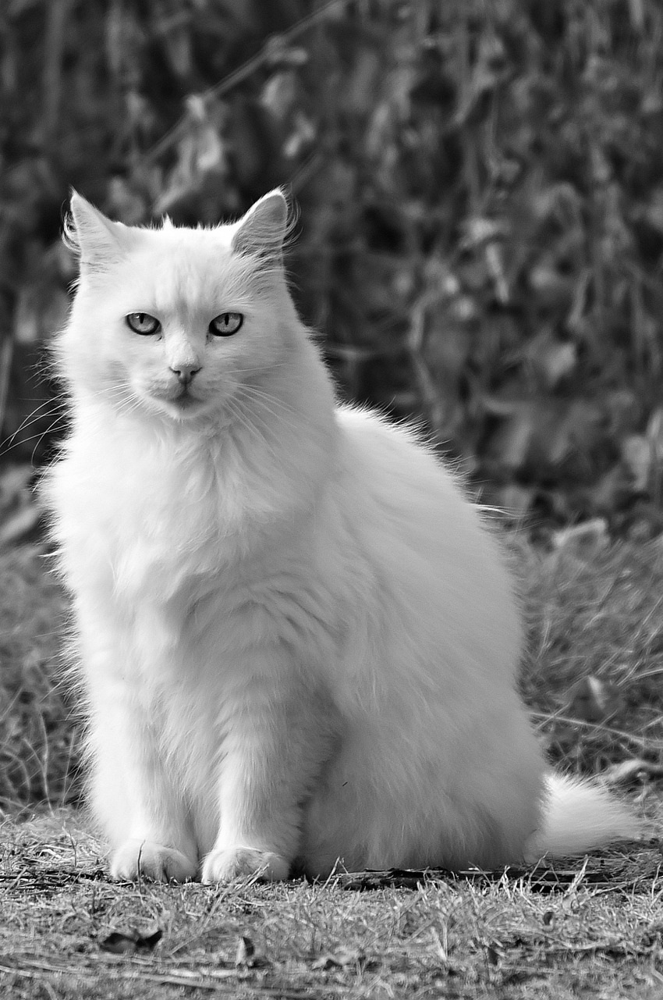

In [ ]:
img_cat_gray = img_cat.convert("L")
img_cat_gray


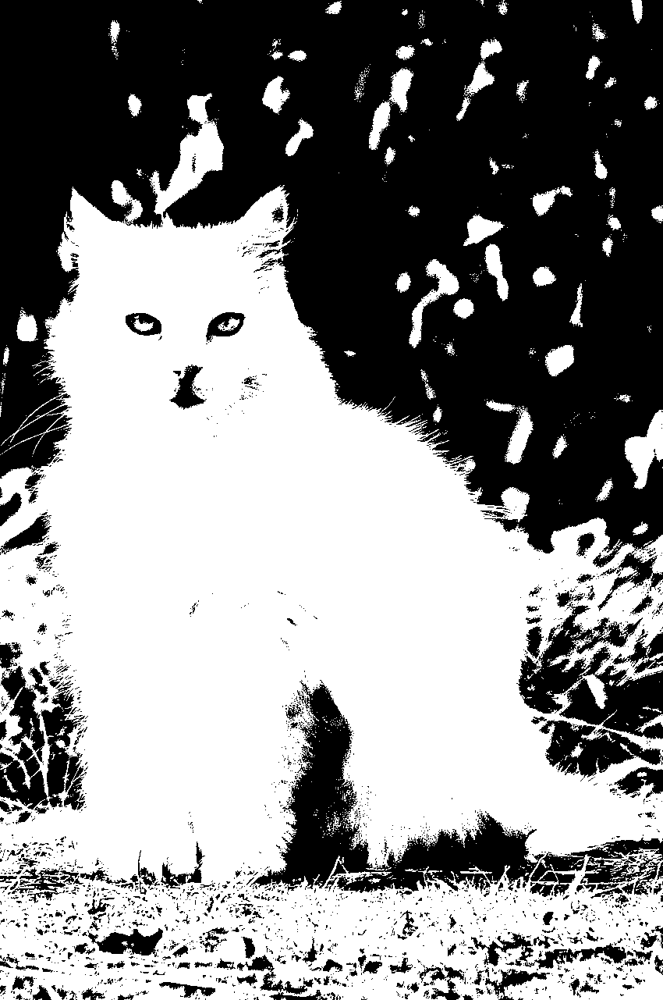

In [ ]:
threshold = 100
img_cat_threshold = img_cat_gray.point(
    lambda x: 255 if x > threshold else 0
)
img_cat_threshold

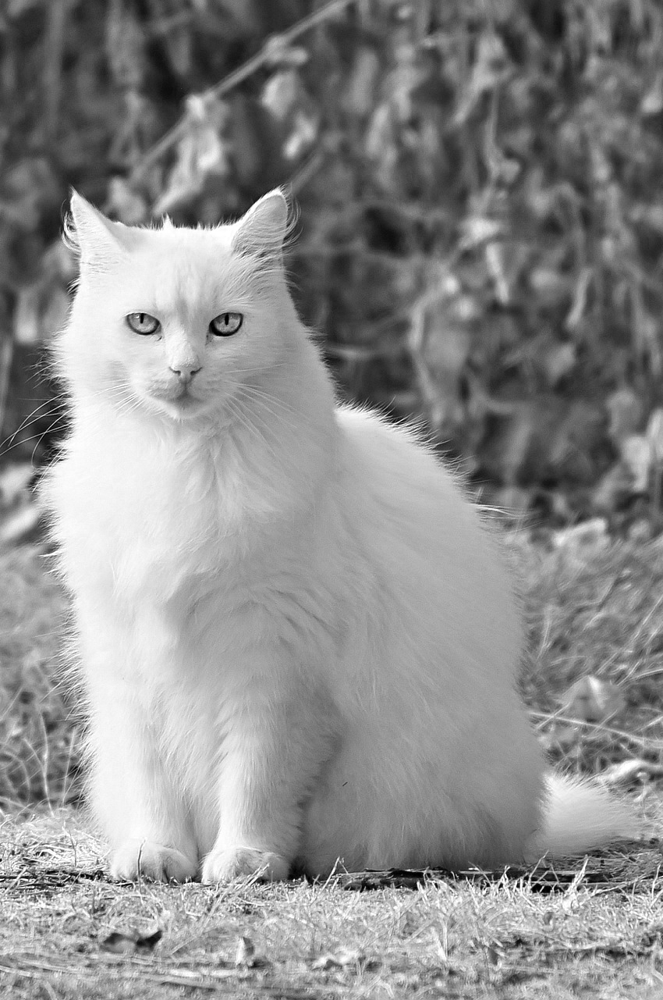

In [ ]:
red, green, blue = img_cat.split()
red


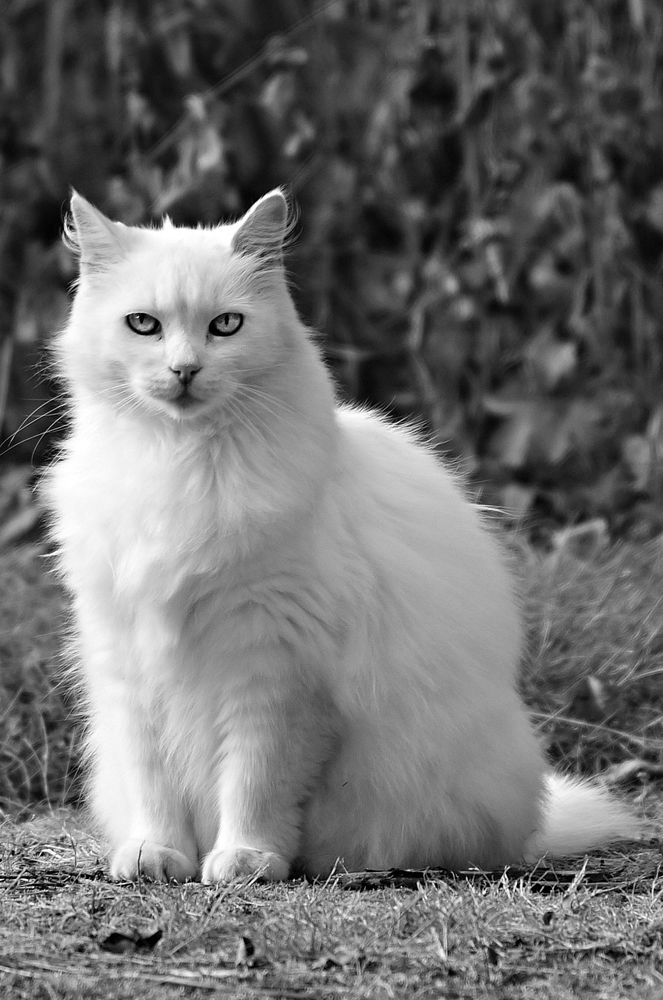

In [ ]:
green


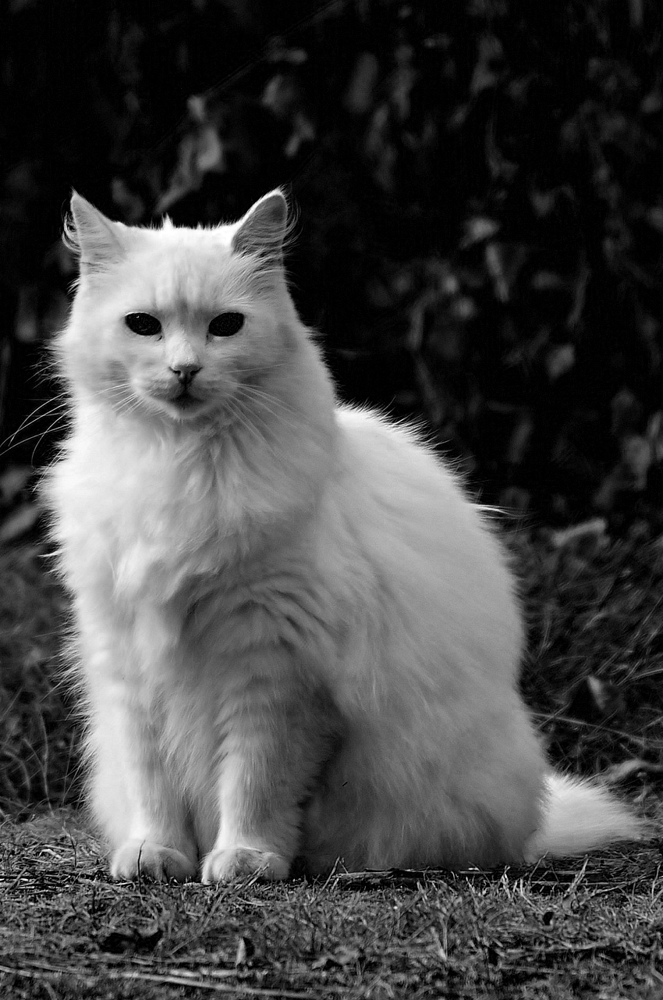

In [ ]:
blue


El canal azul tiene un mayor contraste entre los píxeles que representan al gato y los que representan el fondo. Puede usar la imagen del canal azul para establecer el umbral:

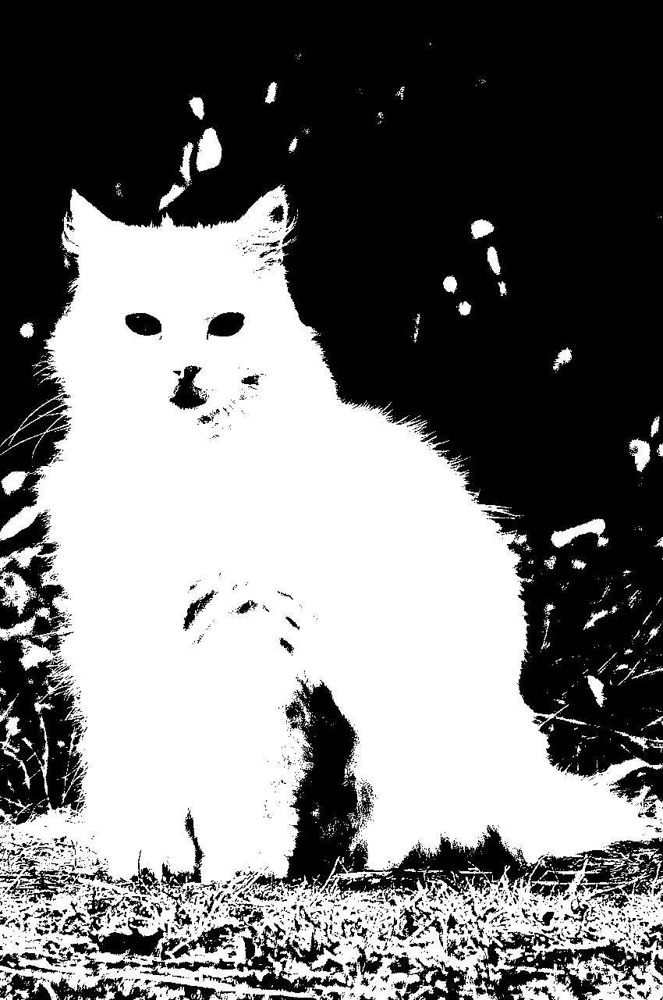

In [ ]:
threshold = 57
img_cat_threshold = blue.point(lambda x: 255 if x > threshold else 0)
img_cat_threshold = img_cat_threshold.convert("1")
img_cat_threshold

Utiliza un valor de umbral de 57 en este ejemplo. También convierte la imagen en un modo binario usando "1" como argumento para `.convert()`. Los píxeles de una imagen binaria solo pueden tener los valores 0 o 1.

Nota: cuando se trata de ciertos formatos de imagen, como JPEG, que dependen de la compresión con pérdida, las imágenes pueden variar ligeramente según los decodificadores JPEG que esté utilizando. Por lo tanto, es posible que tengas que ajustar ligeramente el valor del umbral si los resultados no coinciden con los que se muestran en este ejemplo.

Puedes identificar al gato en esta imagen en blanco y negro. Sin embargo, quieren tener una imagen en la que todos los píxeles que corresponden al gato sean blancos y todos los demás píxeles sean negros. En esta imagen, todavía tiene regiones negras en el área que corresponde al gato, como donde están los ojos, la nariz y la boca, y también tiene píxeles blancos en otras partes de la imagen.

Dentro de pillow estan las técnicas de procesamiento de imágenes llamadas erosión y dilatación para crear una mejor máscara que represente al gato.

## Erosion y dilatacion.

El lado izquierdo de esta imagen binaria muestra un punto blanco sobre un fondo negro, mientras que el lado derecho muestra un agujero negro en una sección blanca sólida.

La erosión es el proceso de eliminar los píxeles blancos de los límites de una imagen. Se puede lograr esto en una imagen binaria utilizando `ImageFilter.MinFilter(3)` como argumento para el método `.filter().` Este filtro reemplaza el valor de un píxel con el valor mínimo de los nueve píxeles en la matriz de 3x3 centrada alrededor del píxel. En una imagen binaria, esto significa que un píxel tendrá el valor de cero si alguno de sus píxeles vecinos es cero.


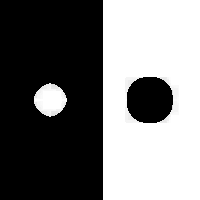

In [ ]:
from PIL import ImageFilter
filename = "/content/drive/MyDrive/Datasets/dotadot.jpg"

with Image.open(filename) as img:
    img.load()
for _ in range(3):
    img = img.filter(ImageFilter.MinFilter(3))
img

Origninalmente en la imagen ambos circulos estaban del mismo tamano. La dilatación es el proceso opuesto a la erosión. Los píxeles blancos se agregan a los límites de una imagen binaria. Puede lograr la dilatación utilizando ImageFilter.MaxFilter(3), que convierte un píxel en blanco si alguno de sus vecinos es blanco.

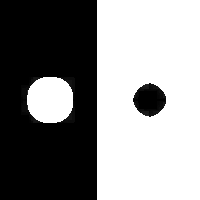

In [ ]:
with Image.open(filename) as img:
    img.load()
for _ in range(3):
    img = img.filter(ImageFilter.MaxFilter(3))
img


Puede usar la erosión y la dilatación juntas para rellenar huecos y eliminar objetos pequeños de una imagen binaria.

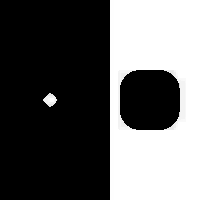

In [ ]:
with Image.open(filename) as img:
    img.load()

for _ in range(10):
    img = img.filter(ImageFilter.MinFilter(3))

img

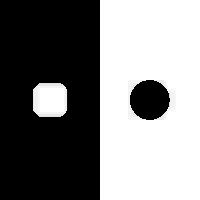

In [ ]:
for _ in range(10):
    img = img.filter(ImageFilter.MaxFilter(3))
img

## Segmentacion de imagen con Tresholding.

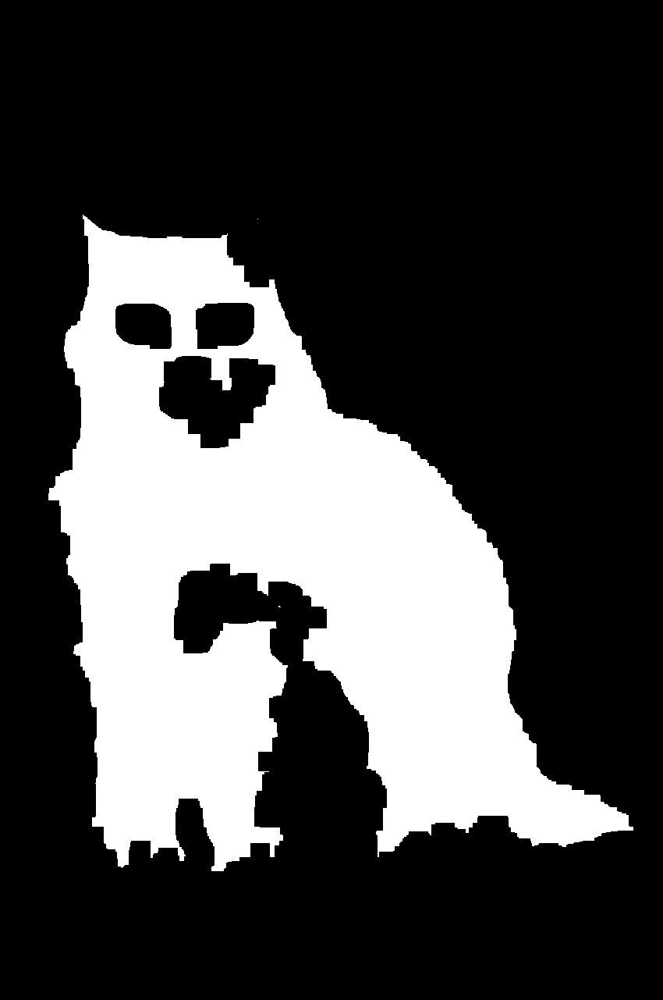

In [ ]:
def erode(cycles, image):
    for _ in range(cycles):
         image = image.filter(ImageFilter.MinFilter(3))
    return image


def dilate(cycles, image):
    for _ in range(cycles):
         image = image.filter(ImageFilter.MaxFilter(3))
    return image
    
step_1 = erode(12, img_cat_threshold)
step_1


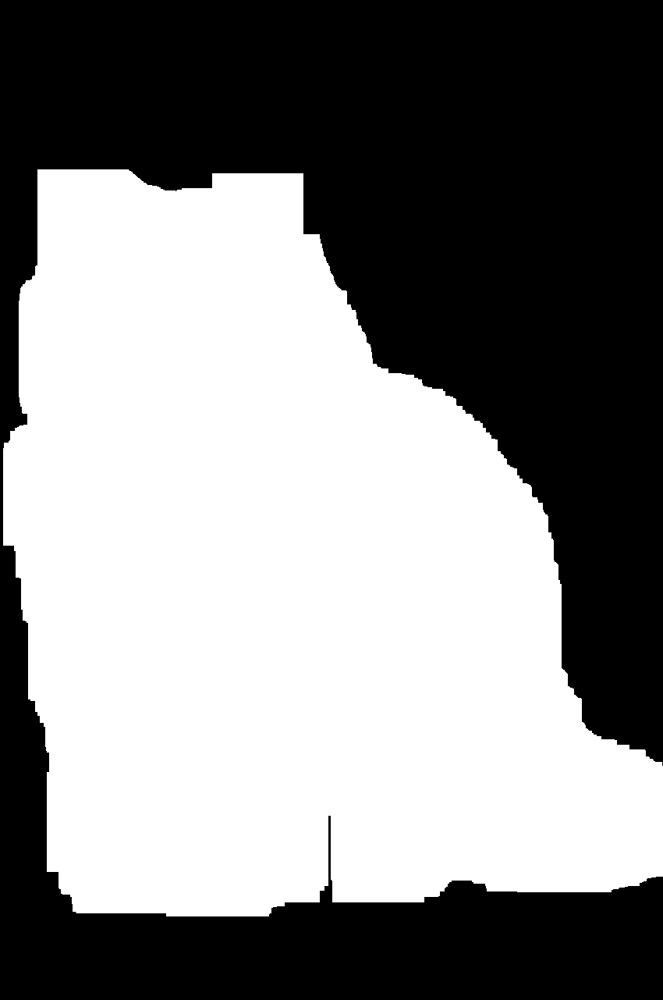

In [ ]:
step_2 = dilate(58, step_1)
step_2

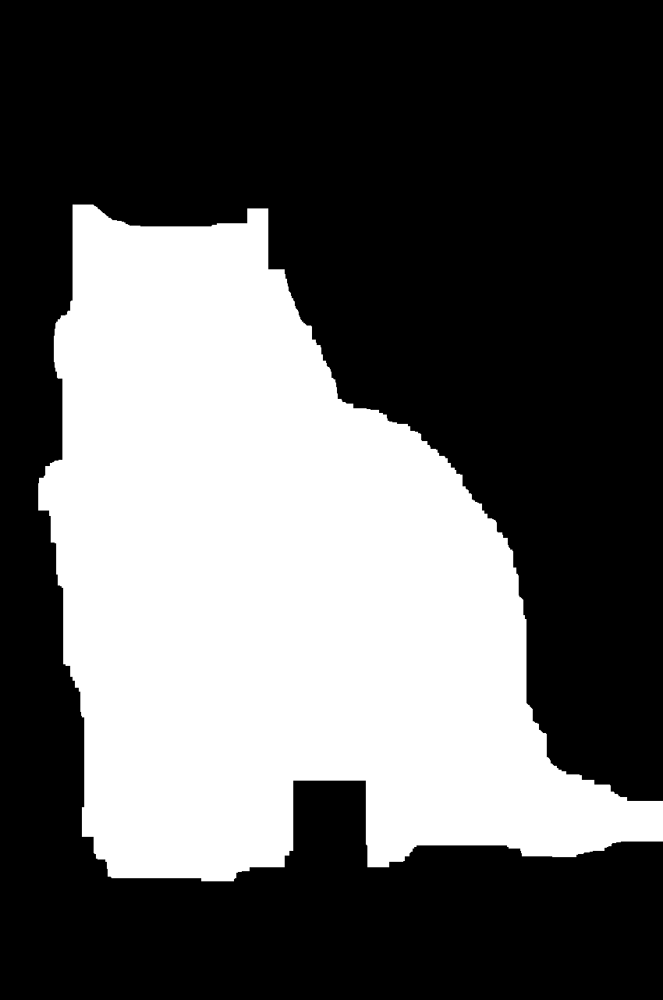

In [ ]:
cat_mask = erode(45, step_2)
cat_mask

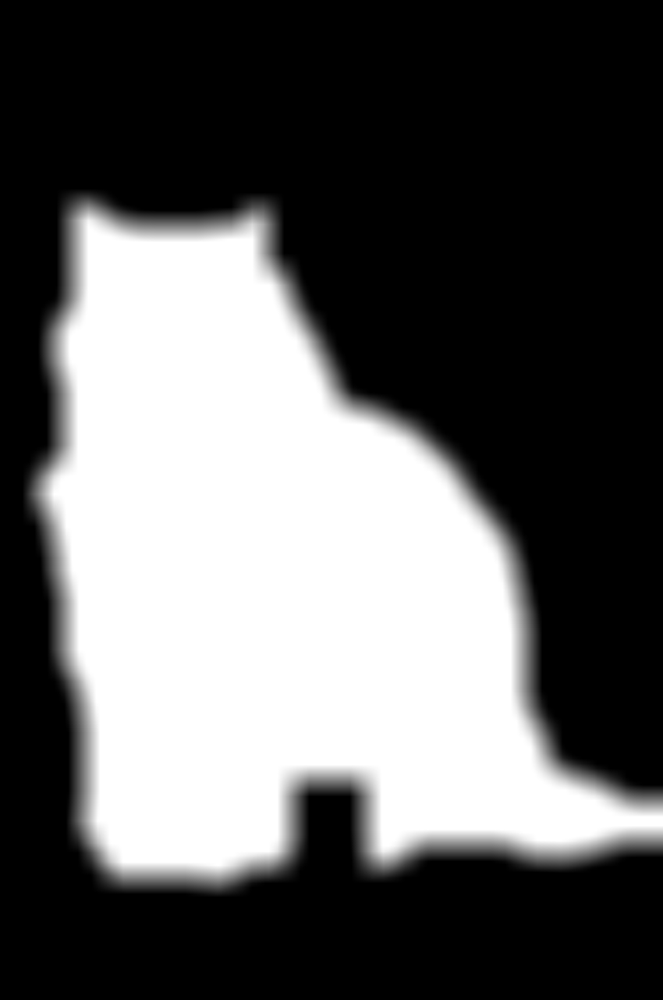

In [ ]:
cat_mask = cat_mask.convert("L")
cat_mask = cat_mask.filter(ImageFilter.BoxBlur(20))
cat_mask

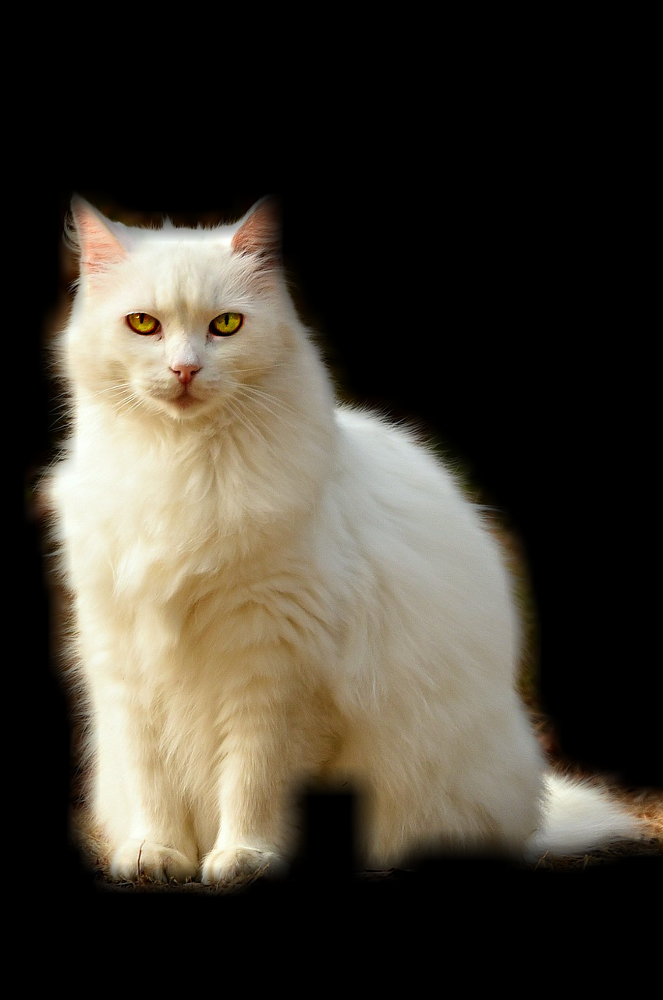

In [ ]:
blank = img_cat.point(lambda _: 0)
cat_segmented = Image.composite(img_cat, blank, cat_mask)
cat_segmented

## Superposision de imagenes

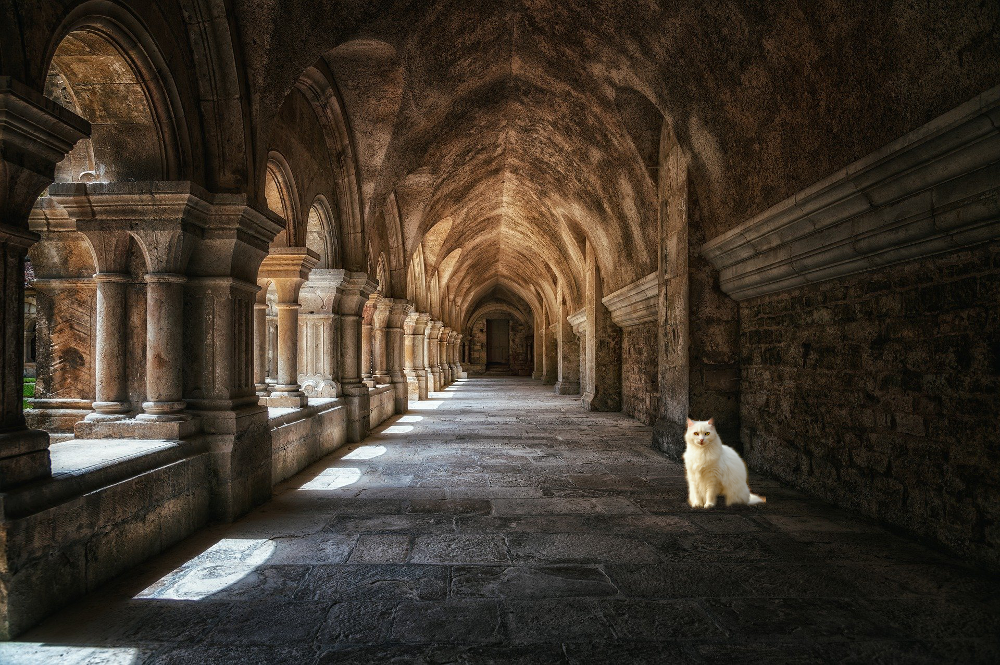

In [ ]:
filename_monastery = "/content/drive/MyDrive/Datasets/hogwarts.jpg"
with Image.open(filename_monastery) as img_monastery:
    img_monastery.load()

img_monastery.paste(
    img_cat.resize((img_cat.width // 5, img_cat.height // 5)),
    (1300, 750),
    cat_mask.resize((cat_mask.width // 5, cat_mask.height // 5)),
)

img_monastery

Para esta seccion utilizamos el formato `paste()` en donde agregamos una imagen a otra. Este metodo puede cambiar en tres parametros:

1. El primer argumento es la imagen que tu quieres agregar. En este caso estamos modificando el tamano de la imagen a un quinto del tamano de la imagen de fondo con el operador //.

2. El segundo argumento es la localizacion (location) de la imagen principal y la imagen secundaria. Esta tupla incluye las coordenadas de la imagen principal y en este caso mencionamos que queremos que se ponga la imagen secundaria.

3. El tercer argumento es la marcara que usamos si no queremos pegar toda la imagen.

## Crear una marca de agua

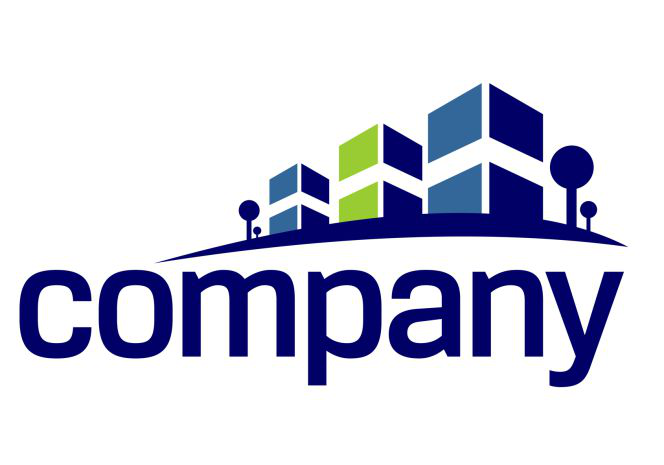

In [ ]:
logo = "/content/drive/MyDrive/Datasets/company.jpg"
with Image.open(logo) as img_logo:
    img_logo.load()


img_logo = Image.open(logo)
img_logo

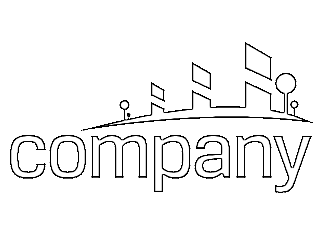

In [ ]:
img_logo = img_logo.convert("L")
threshold = 50
img_logo = img_logo.point(lambda x: 255 if x > threshold else 0)
img_logo = img_logo.resize(
    (img_logo.width // 2, img_logo.height // 2)
)
img_logo = img_logo.filter(ImageFilter.CONTOUR)
img_logo

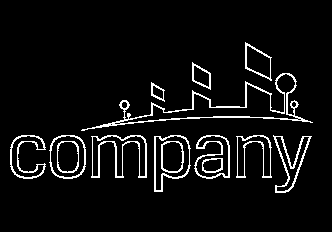

In [ ]:
img_logo = img_logo.point(lambda x: 0 if x == 255 else 255)
img_logo

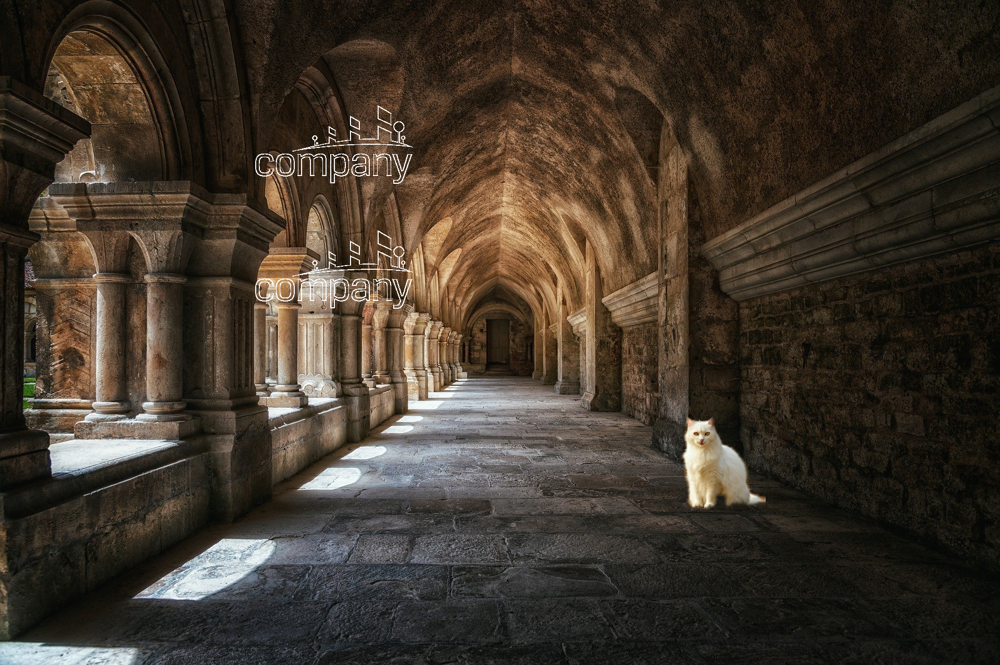

In [ ]:
img_monastery.paste(img_logo, (480, 400), img_logo)
img_monastery

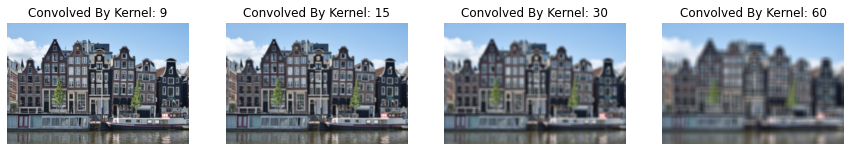

In [ ]:
import numpy as np
import imageio
import matplotlib.pyplot as plt
from scipy.signal import convolve2d

def Convolution(image, kernel):
  conv_bucket= []
  for d in range(image.ndim):
    conv_channel= convolve2d(image[:,:,d], kernel, 
                               mode="same", boundary="symm")
    conv_bucket.append(conv_channel)
  return np.stack(conv_bucket, axis=2).astype("uint8")


kernel_sizes= [9,15,30,60]  
fig, axs=plt.subplots(nrows=1, ncols=len(kernel_sizes), figsize=(15,15));

pic =imageio.imread('/content/drive/MyDrive/Datasets/buildings.jpg')

for k, ax in zip(kernel_sizes, axs):
  kernel =np.ones((k,k))
  kernel /=np.sum(kernel)
  ax.imshow(Convolution(pic, kernel));
  ax.set_title("Convolved By Kernel: {}".format(k));
  ax.set_axis_off();